In [1]:
import pandas as pd
import numpy as np
import plotly.io as pio
# set the seed
np.random.seed(99)

In [2]:
from fb_prophet import *
import sys
from pathlib import Path

# Get the parent directory of the current notebook
parent_dir = Path().resolve().parent

# Add the parent directory to sys.path
sys.path.append(str(parent_dir))

# Import the utils module
from utils import arbitrage_pipeline_benth

/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/.venv/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# File path to the CSV data
file_path = '../data/Day Ahead Auction Prices.csv'

# Load and preprocess the data
day_ahead = load_day_ahead_prices(file_path)

# Prepare the DataFrame for Prophet
df = day_ahead.reset_index().rename(columns={'datetime': 'ds', 'price': 'y'})
df

,ds,y
0,2016-01-01 00:00:00,23.86
1,2016-01-01 01:00:00,22.39
2,2016-01-01 02:00:00,20.59
3,2016-01-01 03:00:00,16.81
4,2016-01-01 04:00:00,17.41
...,...,...
73771,2024-05-31 19:00:00,107.94
73772,2024-05-31 20:00:00,115.00
73773,2024-05-31 21:00:00,107.91
73774,2024-05-31 22:00:00,101.74


In [4]:
# Get the last date in the dataset
last_date = df['ds'].max()

# Define train-test split
train_end_date = last_date - pd.Timedelta(days=365)
train_df = df[df['ds'] <= train_end_date]
test_df = df[df['ds'] > train_end_date]

# Define the parameter grid
param_grid = {
    'growth': ['flat'],
    # 'yearly_seasonality': [True, False],
    # 'weekly_seasonality': [True, False],
    # 'daily_seasonality': [True, False],
    # 'seasonality_mode': ['additive', 'multiplicative'],
    # # 'changepoint_prior_scale': [0.001, 0.01, 0.1], #  range [0.001, 0.5] 
    # 'seasonality_prior_scale': [0.01, 0.1, 1, 10], # range:[0.01, 10]
    # 'holidays_prior_scale': [0.01, 0.1, 1, 10] # range [0.01, 10]
}

In [5]:
# Perform hyperparameter tuning
horizon = '365 days'
tuning_results = tune_hyperparameters(train_df, param_grid, horizon)
tuning_results

Training period: 2016-01-01 00:00:00 to 2023-06-01 23:00:00


15:46:13 - cmdstanpy - INFO - Chain [1] start processing
15:46:14 - cmdstanpy - INFO - Chain [1] done processing
15:46:16 - cmdstanpy - INFO - Chain [1] start processing
15:46:17 - cmdstanpy - INFO - Chain [1] done processing
15:46:17 - cmdstanpy - INFO - Chain [1] start processing
15:46:17 - cmdstanpy - INFO - Chain [1] start processing
15:46:17 - cmdstanpy - INFO - Chain [1] done processing
15:46:18 - cmdstanpy - INFO - Chain [1] start processing
15:46:18 - cmdstanpy - INFO - Chain [1] done processing
15:46:18 - cmdstanpy - INFO - Chain [1] start processing
15:46:18 - cmdstanpy - INFO - Chain [1] done processing
15:46:19 - cmdstanpy - INFO - Chain [1] done processing


,growth,avg_rmse,avg_mae,cutoff_date,fold_rmse,fold_mae
0,flat,81.875736,62.525679,2018-06-02 23:00:00,20.398414,17.204179
1,flat,81.875736,62.525679,2019-06-02 23:00:00,14.322515,9.779354
2,flat,81.875736,62.525679,2020-06-01 23:00:00,20.620224,15.166796
3,flat,81.875736,62.525679,2021-06-01 23:00:00,142.155770,115.444320
4,flat,81.875736,62.525679,2022-06-01 23:00:00,211.881759,155.033748


In [6]:
tuning_results

,growth,avg_rmse,avg_mae,cutoff_date,fold_rmse,fold_mae
0,flat,81.875736,62.525679,2018-06-02 23:00:00,20.398414,17.204179
1,flat,81.875736,62.525679,2019-06-02 23:00:00,14.322515,9.779354
2,flat,81.875736,62.525679,2020-06-01 23:00:00,20.620224,15.166796
3,flat,81.875736,62.525679,2021-06-01 23:00:00,142.155770,115.444320
4,flat,81.875736,62.525679,2022-06-01 23:00:00,211.881759,155.033748


Best Hyperparameters: {'growth': 'flat', 'avg_rmse': 81.87573649902788}


/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/models/fb_prophet.py:315: FutureWarning: 'AS' is deprecated and will be removed in a future version, please use 'YS' instead.
  year_ticks = pd.date_range(start='2016-01-01', end='2024-01-01', freq='AS')  # 'AS' means 'Year Start'
/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/models/fb_prophet.py:315: FutureWarning: 'AS' is deprecated and will be removed in a future version, please use 'YS' instead.
  year_ticks = pd.date_range(start='2016-01-01', end='2024-01-01', freq='AS')  # 'AS' means 'Year Start'
/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/models/fb_prophet.py:315: FutureWarning: 'AS' is deprecated and will be removed in a future version, please use 'YS' instead.
  year_ticks = pd.date_range(start='2016-01-01', end='2024-01-01', freq='AS')  # 'AS' means 'Year Start'
/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/models/fb_prophet.py:315: FutureWarning: 'AS' is de

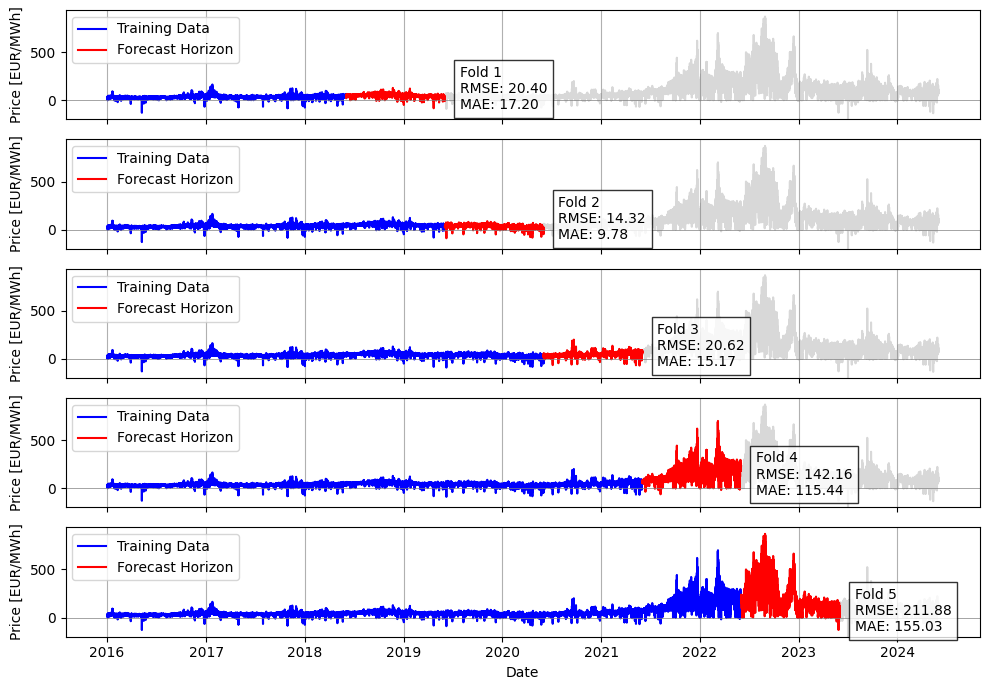

In [7]:
# Call the function with your data
fig = plot_cv_results(df, tuning_results, horizon, param_grid)
fig.show()

In [8]:
# Fit the best model
best_params = tuning_results.loc[tuning_results['avg_rmse'].idxmin()].to_dict()
m = Prophet(**{k: v for k, v in best_params.items() if k not in ['avg_rmse', 'avg_mae', 'fold_rmse', 'fold_mae', 'cutoff_date']})
m.add_country_holidays(country_name='DE')
m.fit(train_df)
print("best_params", best_params)

15:46:23 - cmdstanpy - INFO - Chain [1] start processing
15:46:24 - cmdstanpy - INFO - Chain [1] done processing


best_params {'growth': 'flat', 'avg_rmse': 81.87573649902788, 'avg_mae': 62.52567942769129, 'cutoff_date': Timestamp('2018-06-02 23:00:00'), 'fold_rmse': 20.398413712888647, 'fold_mae': 17.204179026656806}


In [9]:
# Forecast future values
future = m.make_future_dataframe(periods=365 * 24, freq='h')  # 1-year forecast
forecast = m.predict(future)

# Evaluate model on test set
y_test = test_df['y']
y_pred = forecast.loc[forecast['ds'].isin(test_df['ds']), 'yhat']

metrics = evaluate_model(y_test.values, y_pred.values)

print(f"Out-of-sample RMSE: {metrics['RMSE']:.2f}")
print(f"Out-of-sample MAE: {metrics['MAE']:.2f}")
print(f"Out-of-sample MAPE: {metrics['MAPE']:.2f}")

Out-of-sample RMSE: 37.55
Out-of-sample MAE: 28.16
Out-of-sample MAPE: 259478442867.87


In [10]:
y_pred

65016    48.264405
65017    44.784413
65018    40.512000
65019    37.430918
65020    38.952221
           ...    
73771    75.554138
73772    71.288577
73773    62.110884
73774    52.628950
73775    45.939554
Name: yhat, Length: 8760, dtype: float64

In [11]:
test_df

,ds,y
65016,2023-06-02 00:00:00,83.59
65017,2023-06-02 01:00:00,79.40
65018,2023-06-02 02:00:00,79.85
65019,2023-06-02 03:00:00,77.42
65020,2023-06-02 04:00:00,81.12
...,...,...
73771,2024-05-31 19:00:00,107.94
73772,2024-05-31 20:00:00,115.00
73773,2024-05-31 21:00:00,107.91
73774,2024-05-31 22:00:00,101.74


In [12]:
# Plot the training data, 1-year forecast, and 5-year forecast
fig = plot_1_year_forecast(train_df, forecast)

# Save as SVG
fig.show()

## Residual plot for 1-year forecast

In [13]:
fig = plot_residuals(y_true=test_df, y_pred=y_pred, start_date='2024-01-01', end_date='2024-02-01')
fig.show()


                          y
ds                         
2023-06-02 00:00:00   83.59
2023-06-02 01:00:00   79.40
2023-06-02 02:00:00   79.85
2023-06-02 03:00:00   77.42
2023-06-02 04:00:00   81.12
...                     ...
2024-05-31 19:00:00  107.94
2024-05-31 20:00:00  115.00
2024-05-31 21:00:00  107.91
2024-05-31 22:00:00  101.74
2024-05-31 23:00:00   84.18

[8760 rows x 1 columns]
ds
2023-06-02 00:00:00    48.264405
2023-06-02 01:00:00    44.784413
2023-06-02 02:00:00    40.512000
2023-06-02 03:00:00    37.430918
2023-06-02 04:00:00    38.952221
                         ...    
2024-05-31 19:00:00    75.554138
2024-05-31 20:00:00    71.288577
2024-05-31 21:00:00    62.110884
2024-05-31 22:00:00    52.628950
2024-05-31 23:00:00    45.939554
Name: yhat, Length: 8760, dtype: float64
ds
2023-06-02 00:00:00    35.325595
2023-06-02 01:00:00    34.615587
2023-06-02 02:00:00    39.338000
2023-06-02 03:00:00    39.989082
2023-06-02 04:00:00    42.167779
                         ...    
202

In [14]:
fig = plot_residuals2(y_true=test_df, y_pred=y_pred, start_date='2024-01-01', end_date='2024-02-01')
fig.show()


/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/models/fb_prophet.py:238: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/adrianscholl/LRZ Sync+Share/Projects/price-forward-curve/models/fb_prophet.py:239: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



### 5-Year Forecast

In [15]:
# Refit the model on the entire dataset
print("Refitting the model on the entire dataset for a 5-year forecast...")
m_full = Prophet(**{k: v for k, v in best_params.items() if k not in ['avg_rmse', 'avg_mae', 'fold_rmse', 'fold_mae', 'cutoff_date']})
m_full.add_country_holidays(country_name='DE')
m_full.fit(df)

# Forecast 5 years into the future
future_full = m_full.make_future_dataframe(periods=5 * 365 * 24, freq='h')  # 5-year forecast
forecast_full = m_full.predict(future_full)

# Save the 5-year forecast to a CSV file
forecast_full.to_csv('../data/fb_prophet_5year_forecast.csv', index=False)
print("5-year forecast saved as fb_prophet_5year_forecast.csv")

# Plot the training data, and 5-year forecast
fig = plot_5_year_forecast(train_df, forecast_full)

# Save as SVG
# fig.write_image("images/5_year_forecast.svg")
fig.show()


Refitting the model on the entire dataset for a 5-year forecast...


15:47:34 - cmdstanpy - INFO - Chain [1] start processing
15:47:35 - cmdstanpy - INFO - Chain [1] done processing


5-year forecast saved as fb_prophet_5year_forecast.csv


### Residual Plot

### Components

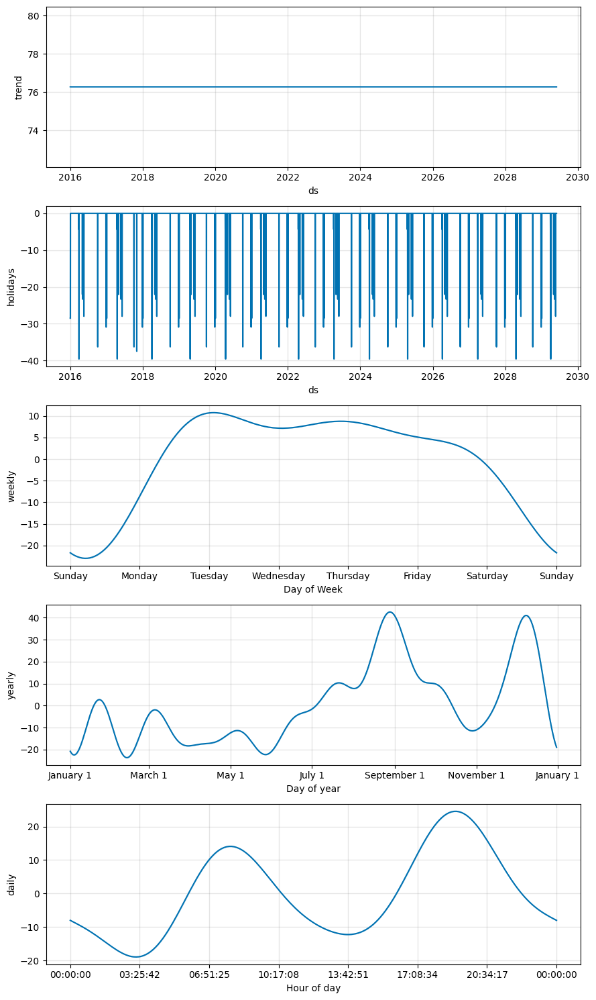

In [16]:
fig = m_full.plot_components(forecast_full)